In [1]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tsmoothie.smoother import *
from tsmoothie.utils_func import create_windows

In [2]:
import ast
with open("C:/Users/troya/Desktop/data/Data for students/mHealth - Teamprojects/UNITI Apps/Answersheets.csv", 'r') as file:
    df = pd.read_csv(file, index_col=0)
    df = df.drop(10546, axis=0)
    df = df[df['questionnaire_id'] == 17].reset_index()
    ans = df['answers']
    for j in range(len(ans)):
        answers = ans[j]
        answers = answers.replace("[", "")
        answers = answers.replace("]", "")
        answers = answers[:-1].split("}")
        

        for i in range(len(answers)):
            answers[i] = answers[i] + '}'
            answers[i] = answers[i].replace(',{', '{')
            answers[i] = ast.literal_eval(answers[i])

        df.at[j,'answers'] = answers

    answers_df = pd.DataFrame([{l['label']: l['value'] for l in r} for r in ans])
    answers_df['user_id'] = df['user_id']
    answers_df['ts'] = df['collected_at']
    temp_cols = answers_df.columns.tolist()
    new_cols = temp_cols[-2:] + temp_cols[:-2]
    answers_df = answers_df[new_cols]

    answers_df = answers_df.convert_dtypes()

    print(answers_df)

       user_id                   ts  loudness  cumberness  jawbone  neck  \
0        42101  2021-04-13 20:35:15       100          11       80    34   
1          153  2021-04-14 07:52:28        79          58       45    62   
2          101  2021-04-14 08:21:51        75          79       82    71   
3          101  2021-04-14 08:23:12        33          77       76    64   
4          137  2021-04-14 11:39:48        33          13       48    51   
...        ...                  ...       ...         ...      ...   ...   
15960    40273  2022-01-11 22:37:03        30          32       38    43   
15961    40306  2022-01-11 22:59:30        59          60       29    34   
15962    40242  2022-01-11 23:16:59        26          18       29    17   
15963    34222  2022-01-11 23:33:55        44          35       65    58   
15964    36355  2022-01-11 23:59:54        59          59       49    46   

       tin_day  tin_cumber  tin_max  movement  stress  emotion  diary_q11  \
0         

In [3]:
answers_df = answers_df.drop(['tinedu_3_q1','tinedu_3_q2','tinedu_3_q3','tinedu_3_q4','diary_q11','diary_q11'], axis=1)

In [14]:
#convert the data type of column to int
answers_df = answers_df.astype({'loudness':'int','cumberness':'int','jawbone':'int','neck':'int', 'tin_day':'int','tin_cumber':'int','tin_max':'int','movement':'int','stress':'int','emotion':'int'})

In [18]:
#convert to date 
answers_df['ts']=pd.to_datetime(answers_df['ts'], format="%Y-%m-%d %H:%M:%S")

In [ ]:
user['ts_date'] = pd.to_datetime(user.ts, format="%Y-%m-%d %H:%M:%S").apply(lambda x: x.date())

In [7]:
# mean value group by day, for every single user, as a user can entry multiple value per day
answers_df = answers_df.groupby(['user_id', 'ts'], as_index=False).mean()

In [19]:
answers_df.dtypes

user_id                Int64
ts            datetime64[ns]
loudness               int32
cumberness             int32
jawbone                int32
neck                   int32
tin_day                int32
tin_cumber             int32
tin_max                int32
movement               int32
stress                 int32
emotion                int32
dtype: object

In [22]:
answers_df['loudness'] = answers_df['loudness'].astype('int')
answers_df['cumberness'] = answers_df['cumberness'].astype('int')
answers_df['jawbone'] = answers_df['jawbone'].astype('int')
answers_df['neck'] = answers_df['neck'].astype('int')
answers_df['tin_day'] = answers_df['tin_day'].astype('int')
answers_df['tin_cumber'] = answers_df['tin_cumber'].astype('int')
answers_df['tin_max'] = answers_df['tin_max'].astype('int')
answers_df['movement'] = answers_df['movement'].astype('int')
answers_df['stress'] = answers_df['stress'].astype('int')
answers_df['emotion'] = answers_df['emotion'].astype('int')

In [23]:
### USE KALMAN FILTER TO SMOOTH ALL DATA (ONLY VISUALIZATION PURPOSE) ###

smoother = KalmanSmoother(component='level', 
                          component_noise={'level':0.1 }, 
                          )
smoother.smooth(answers_df[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']].T)

<tsmoothie.smoother.KalmanSmoother>

In [24]:
##### NORMALIZING #####

a_df=answers_df[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']]
#a_df=answers_df[['loudness','cumberness','jawbone']]
normalized_df=(a_df-a_df.min())/(a_df.max()-a_df.min())

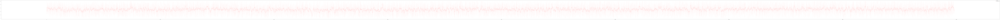

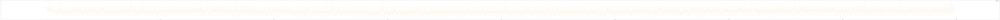

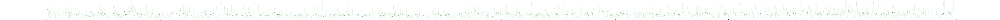

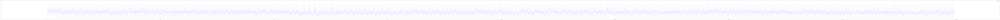

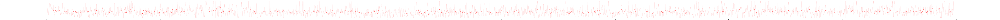

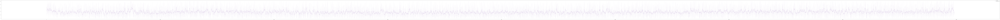

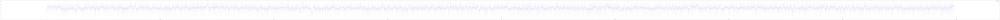

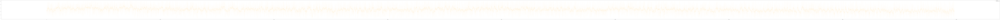

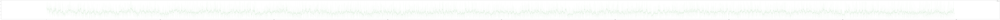

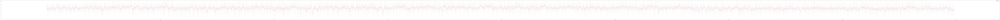

In [25]:
### PLOT RAW vs SMOOTHED DATA ###

color = {0:'red', 1:'orange', 2:'green',3:'blue', 4:'red', 5:'indigo',6:'blue', 7:'orange', 8:'green',9:'red'}

for i,name in enumerate(normalized_df.columns):
    plt.figure(figsize=(500,10))
    
    plt.plot(df.index, smoother.data[i], c=color[i], label=name, alpha=0.4, linewidth=0.2, markersize=12)
    plt.plot(df.index, smoother.smooth_data[i], c=color[i], label=name+' smooth', linewidth=0.5, markersize=12)
    plt.legend(); 
    plt.show()

In [26]:
#here make the data frame with time as index
#final_df= answers_df[['ts']].append(normalized_df, ignore_index=False)
vis_df=pd.concat([answers_df[['ts']], normalized_df], axis=1)
#final_df.iloc[5100:5315] 

vis_df.head()
#final uses ts as index, vis is not

,ts,loudness,cumberness,jawbone,neck,tin_day,tin_cumber,tin_max,movement,stress,emotion
0,2021-04-13 20:35:15,1.00,0.11,0.80,0.34,0.41,0.86,0.27,0.37,0.90,1.00
1,2021-04-14 07:52:28,0.79,0.58,0.45,0.62,0.82,0.86,0.77,0.55,0.44,0.81
2,2021-04-14 08:21:51,0.75,0.79,0.82,0.71,0.67,0.82,0.78,0.78,0.71,0.67
3,2021-04-14 08:23:12,0.33,0.77,0.76,0.64,0.21,0.73,0.65,0.30,0.92,0.67
4,2021-04-14 11:39:48,0.33,0.13,0.48,0.51,0.15,0.14,0.16,0.30,0.70,0.47


In [27]:
final_df=pd.concat([answers_df[['ts']], normalized_df], axis=1)
final_df.index.name='ts'

final_df.set_index('ts', inplace=True)

final_df.index.name = None

final_df.head()

,loudness,cumberness,jawbone,neck,tin_day,tin_cumber,tin_max,movement,stress,emotion
2021-04-13 20:35:15,1.00,0.11,0.80,0.34,0.41,0.86,0.27,0.37,0.90,1.00
2021-04-14 07:52:28,0.79,0.58,0.45,0.62,0.82,0.86,0.77,0.55,0.44,0.81
2021-04-14 08:21:51,0.75,0.79,0.82,0.71,0.67,0.82,0.78,0.78,0.71,0.67
2021-04-14 08:23:12,0.33,0.77,0.76,0.64,0.21,0.73,0.65,0.30,0.92,0.67
2021-04-14 11:39:48,0.33,0.13,0.48,0.51,0.15,0.14,0.16,0.30,0.70,0.47


# check for stationary - dickey_fuller

In [28]:
from statsmodels.tsa.stattools import adfuller

def dickey_fuller(series,title='Your Dataset'):
    '''Hypothesis Test for stationarity '''
    print(f'Augmented Dickey Fuller Test for the dataset {title}')
    
    result = adfuller(series.dropna(),autolag='AIC')
    labels = ['ADF test statistics','p-value','#lags','#observations'] # use help(adfuller) to understand why these labels are chosen
    
    outcome = pd.Series(result[0:4],index=labels)
    
    for key,val in result[4].items():
        outcome[f'critical value ({key})'] = val
        
    print(outcome.to_string()) # this will not print the line 'dtype:float64'
    
    if result[1] <= 0.05:
        print('Strong evidence against the null hypothesis') # Ho is Data is not stationary, check help(adfuller)
        print('Reject the null hypothesis')
        print('Data is Stationary')
    else:
        print('Weak evidence against the Null hypothesis')
        print('Fail to reject the null hypothesis')
        print('Data has a unit root and is non stationary')

In [29]:
dickey_fuller(final_df['loudness'],title='loudness')

Augmented Dickey Fuller Test for the dataset loudness
ADF test statistics      -123.572782
p-value                     0.000000
#lags                       0.000000
#observations           15964.000000
critical value (1%)        -3.430760
critical value (5%)        -2.861721
critical value (10%)       -2.566866
Strong evidence against the null hypothesis
Reject the null hypothesis
Data is Stationary


# monthly observation wd smoothing

In [30]:
# convert the 'Date' column to datetime format
vis_df['ts'] = pd.to_datetime(vis_df['ts'])
vis_df.dtypes

ts            datetime64[ns]
loudness             float64
cumberness           float64
jawbone              float64
neck                 float64
tin_day              float64
tin_cumber           float64
tin_max              float64
movement             float64
stress               float64
emotion              float64
dtype: object

In [31]:
april= vis_df.loc[(vis_df['ts'].dt.month==4)]
print(april)

                    ts  loudness  cumberness  jawbone  neck  tin_day  \
0  2021-04-13 20:35:15      1.00        0.11     0.80  0.34     0.41   
1  2021-04-14 07:52:28      0.79        0.58     0.45  0.62     0.82   
2  2021-04-14 08:21:51      0.75        0.79     0.82  0.71     0.67   
3  2021-04-14 08:23:12      0.33        0.77     0.76  0.64     0.21   
4  2021-04-14 11:39:48      0.33        0.13     0.48  0.51     0.15   
..                 ...       ...         ...      ...   ...      ...   
95 2021-04-30 19:01:50      0.36        0.34     0.47  0.68     0.43   
96 2021-04-30 19:28:26      0.41        0.44     0.14  0.33     0.50   
97 2021-04-30 20:30:07      0.47        0.20     0.00  0.00     0.41   
98 2021-04-30 20:34:24      0.62        0.15     0.18  0.65     0.50   
99 2021-04-30 21:09:12      0.15        0.17     0.18  0.15     0.17   

    tin_cumber  tin_max  movement  stress  emotion  
0         0.86     0.27      0.37    0.90     1.00  
1         0.86     0.77      

In [32]:
### USE KALMAN FILTER TO SMOOTH ALL DATA (ONLY VISUALIZATION PURPOSE) ###

smoother = KalmanSmoother(component='level', 
                          component_noise={'level':0.1}, 
                          n_longseasons=365)
smoother.smooth(april[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']].T)

<tsmoothie.smoother.KalmanSmoother>

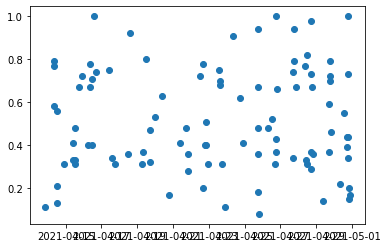

In [33]:
vals = april.values
plt.scatter(vals[:, 0], vals[:, 2])

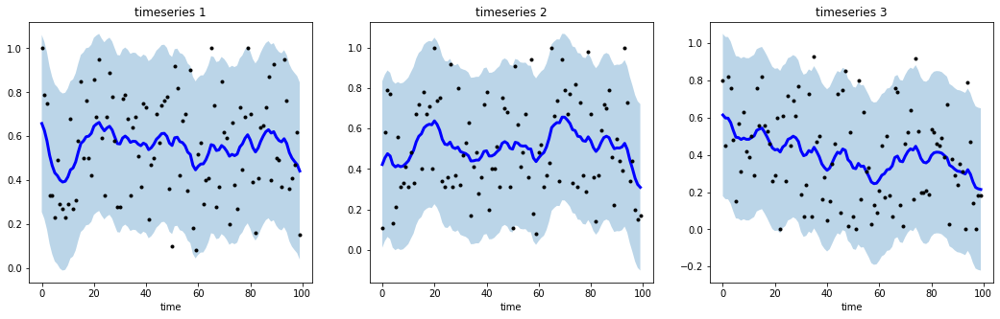

In [34]:
#  Generate range interval (sigma_interval OR kalman_interval )
low, up = smoother.get_intervals('sigma_interval') #'prediction_interval' is not a supported interval type for this smoother. Supported types are ['sigma_interval', 'kalman_interval']

plt.figure(figsize=(18,5))

for i in range(3):
    
    plt.subplot(1,3,i+1)
    plt.plot(smoother.smooth_data[i], linewidth=3, color='blue')
    plt.plot(smoother.data[i], '.k')
    plt.title(f"timeseries {i+1}"); plt.xlabel('time')

    plt.fill_between(range(len(smoother.data[i])), low[i], up[i], alpha=0.3)

# single user


In [39]:
user= pd.concat([answers_df[[ 'user_id','ts']], normalized_df], axis=1)
user1 = user.loc[user['user_id']== 153]
user1.head()

,user_id,ts,loudness,cumberness,jawbone,neck,tin_day,tin_cumber,tin_max,movement,stress,emotion
1,153,2021-04-14 07:52:28,0.79,0.58,0.45,0.62,0.82,0.86,0.77,0.55,0.44,0.81
15,153,2021-04-16 06:11:16,0.85,0.40,0.82,0.14,0.95,0.30,0.69,0.16,0.78,0.94
27,153,2021-04-19 06:51:42,0.78,0.31,0.69,0.49,0.62,0.27,0.70,0.67,0.60,0.59


In [41]:
### USE KALMAN FILTER TO SMOOTH ALL DATA (ONLY VISUALIZATION PURPOSE) ###
# FILTER FOR USER ID >=2101
smoother_u1 = KalmanSmoother(component='level', 
                          component_noise={'level':0.1}, 
                          n_longseasons=365)
smoother_u1.smooth(user1[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']].T)

<tsmoothie.smoother.KalmanSmoother>

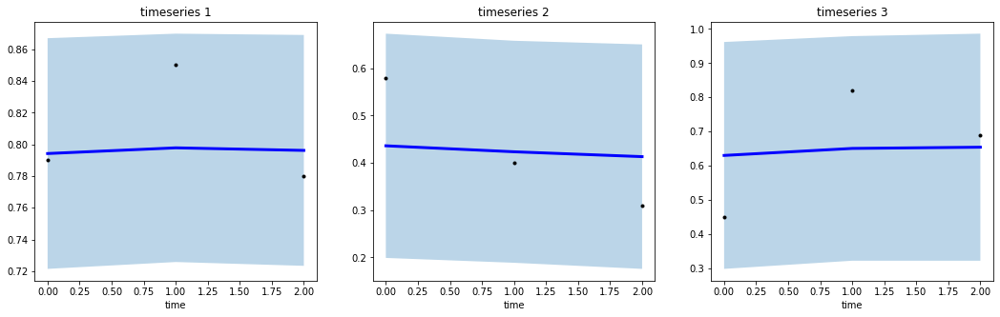

In [43]:
#  Generate range interval (sigma_interval OR kalman_interval )
low, up = smoother_u1.get_intervals('kalman_interval') #'prediction_interval' is not a supported interval type for this smoother. Supported types are ['sigma_interval', 'kalman_interval']

plt.figure(figsize=(18,5))

for i in range(3):
    
    plt.subplot(1,3,i+1)
    plt.plot(smoother_u1.smooth_data[i], linewidth=3, color='blue')
    plt.plot(smoother_u1.data[i], '.k')
    plt.title(f"timeseries {i+1}"); plt.xlabel('time')

    plt.fill_between(range(len(smoother_u1.data[i])), low[i], up[i], alpha=0.3)

In [51]:
user2 = user.loc[user['user_id']== 2146]
user2.head()

,user_id,ts,loudness,cumberness,jawbone,neck,tin_day,tin_cumber,tin_max,movement,stress,emotion
218,2146,2021-05-11 19:14:46,0.41,0.27,0.08,0.37,0.60,0.22,0.64,0.46,0.52,0.26
235,2146,2021-05-12 17:34:30,0.21,0.11,0.02,0.08,0.41,0.29,0.65,0.37,0.30,0.72
253,2146,2021-05-13 17:34:30,0.07,0.07,0.06,0.11,0.26,0.12,0.32,0.15,0.24,0.19
289,2146,2021-05-15 06:11:17,0.53,0.57,0.47,0.71,0.40,0.54,0.60,0.10,0.17,0.31
307,2146,2021-05-15 20:39:23,0.09,0.04,0.09,0.26,0.29,0.15,0.23,0.33,0.21,0.64


In [63]:
user[user.user_id >= 2101].user_id.value_counts()

2146     211
2107     210
2297     173
2385     170
2251     165
        ... 
42148      1
42132      1
2323       1
42427      1
42101      1
Name: user_id, Length: 399, dtype: Int64

In [69]:
user['ts_date'] = pd.to_datetime(user.ts, format="%Y-%m-%d %H:%M:%S").apply(lambda x: x.date())

In [75]:
# mean value of a day, for every single user 
# as a single user may have multiple input for a day
temp = user.groupby(['user_id', 'ts_date'], as_index=False).mean()

In [78]:
temp.user_id.value_counts()[temp.user_id.value_counts()>30]

2107     207
2146     200
2297     172
2385     164
2251     159
        ... 
34390     33
40103     31
34292     31
36231     31
104       31
Name: user_id, Length: 177, dtype: Int64

In [1]:
print(temp)

NameError: name 'temp' is not defined

In [53]:
print(user2.count())

user_id       211
ts            211
loudness      211
cumberness    211
jawbone       211
neck          211
tin_day       211
tin_cumber    211
tin_max       211
movement      211
stress        211
emotion       211
dtype: int64


In [54]:
print(user1.count())

user_id       3
ts            3
loudness      3
cumberness    3
jawbone       3
neck          3
tin_day       3
tin_cumber    3
tin_max       3
movement      3
stress        3
emotion       3
dtype: int64


In [55]:
smoother_u1.smooth(user2[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']].T)

<tsmoothie.smoother.KalmanSmoother>

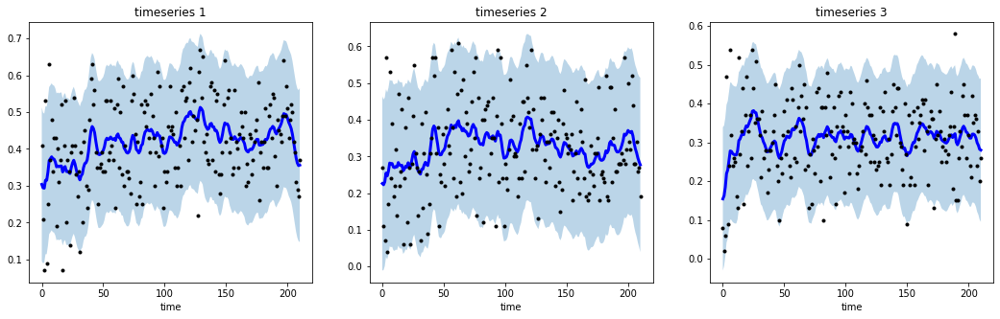

In [56]:
#  Generate range interval (sigma_interval OR kalman_interval )
low, up = smoother_u1.get_intervals('kalman_interval') #'prediction_interval' is not a supported interval type for this smoother. Supported types are ['sigma_interval', 'kalman_interval']

plt.figure(figsize=(18,5))

for i in range(3):
    
    plt.subplot(1,3,i+1)
    plt.plot(smoother_u1.smooth_data[i], linewidth=3, color='blue')
    plt.plot(smoother_u1.data[i], '.k')
    plt.title(f"timeseries {i+1}"); plt.xlabel('time')

    plt.fill_between(range(len(smoother_u1.data[i])), low[i], up[i], alpha=0.3)

In [57]:
print(user2)

       user_id                   ts  loudness  cumberness  jawbone  neck  \
218       2146  2021-05-11 19:14:46      0.41        0.27     0.08  0.37   
235       2146  2021-05-12 17:34:30      0.21        0.11     0.02  0.08   
253       2146  2021-05-13 17:34:30      0.07        0.07     0.06  0.11   
289       2146  2021-05-15 06:11:17      0.53        0.57     0.47  0.71   
307       2146  2021-05-15 20:39:23      0.09        0.04     0.09  0.26   
...        ...                  ...       ...         ...      ...   ...   
15743     2146  2022-01-06 21:47:55      0.39        0.28     0.36  0.38   
15786     2146  2022-01-07 22:19:21      0.31        0.34     0.24  0.23   
15824     2146  2022-01-08 22:22:12      0.29        0.26     0.33  0.26   
15910     2146  2022-01-10 22:26:40      0.27        0.27     0.20  0.26   
15959     2146  2022-01-11 22:26:29      0.37        0.19     0.26  0.21   

       tin_day  tin_cumber  tin_max  movement  stress  emotion  
218       0.60        

In [58]:
user3 = user.loc[user['user_id']== 40121]
user3.head()

,user_id,ts,loudness,cumberness,jawbone,neck,tin_day,tin_cumber,tin_max,movement,stress,emotion
4244,40121,2021-07-23 18:48:25,0.32,0.11,0.13,0.64,0.25,0.12,0.13,0.27,0.37,0.50
4348,40121,2021-07-24 20:19:53,0.22,0.19,0.38,0.85,0.34,0.34,0.63,0.57,0.07,0.56
4421,40121,2021-07-25 18:53:37,0.21,0.12,0.34,1.00,0.47,0.52,0.66,0.53,0.68,0.50
4510,40121,2021-07-26 18:41:27,0.09,0.07,0.10,0.49,0.15,0.12,0.08,0.12,0.34,0.50
4610,40121,2021-07-27 18:51:37,0.10,0.10,0.10,0.41,0.22,0.23,0.34,0.12,0.36,0.50


In [59]:
print(user3)

      user_id                   ts  loudness  cumberness  jawbone  neck  \
4244    40121  2021-07-23 18:48:25      0.32        0.11     0.13  0.64   
4348    40121  2021-07-24 20:19:53      0.22        0.19     0.38  0.85   
4421    40121  2021-07-25 18:53:37      0.21        0.12     0.34  1.00   
4510    40121  2021-07-26 18:41:27      0.09        0.07     0.10  0.49   
4610    40121  2021-07-27 18:51:37      0.10        0.10     0.10  0.41   
4717    40121  2021-07-28 18:51:18      0.10        0.12     0.28  0.74   
4814    40121  2021-07-29 18:52:50      0.00        0.00     0.10  0.36   
4900    40121  2021-07-30 19:22:20      0.08        0.09     0.14  0.52   
4962    40121  2021-07-31 17:43:24      0.01        0.00     0.14  0.23   
5060    40121  2021-08-01 18:00:29      0.17        0.07     0.17  0.33   
5160    40121  2021-08-02 18:12:53      0.01        0.03     0.14  0.54   
5248    40121  2021-08-03 18:24:51      0.05        0.07     0.22  0.86   
5397    40121  2021-08-05

In [60]:
smoother_u1.smooth(user3[['loudness','cumberness','jawbone','neck','tin_day','tin_cumber','tin_max','movement','stress','emotion']].T)

<tsmoothie.smoother.KalmanSmoother>

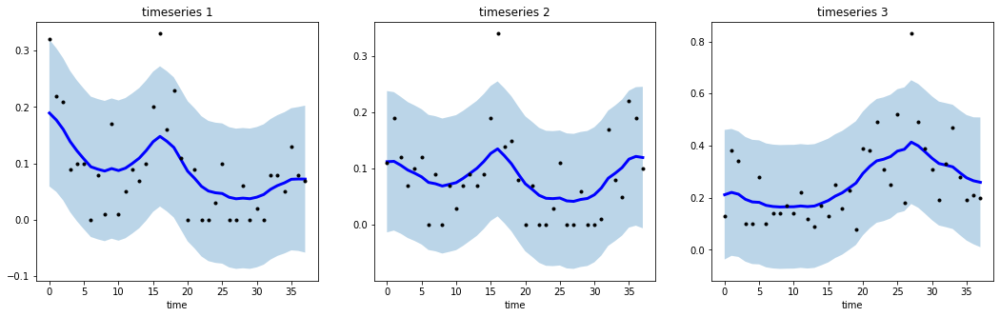

In [61]:
#  Generate range interval (sigma_interval OR kalman_interval )
low, up = smoother_u1.get_intervals('kalman_interval') #'prediction_interval' is not a supported interval type for this smoother. Supported types are ['sigma_interval', 'kalman_interval']

plt.figure(figsize=(18,5))

for i in range(3):
    
    plt.subplot(1,3,i+1)
    plt.plot(smoother_u1.smooth_data[i], linewidth=3, color='blue')
    plt.plot(smoother_u1.data[i], '.k')
    plt.title(f"timeseries {i+1}"); plt.xlabel('time')

    plt.fill_between(range(len(smoother_u1.data[i])), low[i], up[i], alpha=0.3)